### Will a Customer Accept the Coupon?

**Context**

Imagine driving through town and a coupon is delivered to your cell phone for a restaraunt near where you are driving. Would you accept that coupon and take a short detour to the restaraunt? Would you accept the coupon but use it on a sunbsequent trip? Would you ignore the coupon entirely? What if the coupon was for a bar instead of a restaraunt? What about a coffee house? Would you accept a bar coupon with a minor passenger in the car? What about if it was just you and your partner in the car? Would weather impact the rate of acceptance? What about the time of day?

Obviously, proximity to the business is a factor on whether the coupon is delivered to the driver or not, but what are the factors that determine whether a driver accepts the coupon once it is delivered to them? How would you determine whether a driver is likely to accept a coupon?

**Overview**

The goal of this project is to use what you know about visualizations and probability distributions to distinguish between customers who accepted a driving coupon versus those that did not.

**Data**

This data comes to us from the UCI Machine Learning repository and was collected via a survey on Amazon Mechanical Turk. The survey describes different driving scenarios including the destination, current time, weather, passenger, etc., and then ask the person whether he will accept the coupon if he is the driver. Answers that the user will drive there ‘right away’ or ‘later before the coupon expires’ are labeled as ‘Y = 1’ and answers ‘no, I do not want the coupon’ are labeled as ‘Y = 0’.  There are five different types of coupons -- less expensive restaurants (under \\$20), coffee houses, carry out & take away, bar, and more expensive restaurants (\\$20 - \\$50). 

**Deliverables**

Your final product should be a brief report that highlights the differences between customers who did and did not accept the coupons.  To explore the data you will utilize your knowledge of plotting, statistical summaries, and visualization using Python. You will publish your findings in a public facing github repository as your first portfolio piece. 





### Data Description
Keep in mind that these values mentioned below are average values.

The attributes of this data set include:
1. User attributes
    -  Gender: male, female
    -  Age: below 21, 21 to 25, 26 to 30, etc.
    -  Marital Status: single, married partner, unmarried partner, or widowed
    -  Number of children: 0, 1, or more than 1
    -  Education: high school, bachelors degree, associates degree, or graduate degree
    -  Occupation: architecture & engineering, business & financial, etc.
    -  Annual income: less than \\$12500, \\$12500 - \\$24999, \\$25000 - \\$37499, etc.
    -  Number of times that he/she goes to a bar: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
    -  Number of times that he/she buys takeaway food: 0, less than 1, 1 to 3, 4 to 8 or greater
    than 8
    -  Number of times that he/she goes to a coffee house: 0, less than 1, 1 to 3, 4 to 8 or
    greater than 8
    -  Number of times that he/she eats at a restaurant with average expense less than \\$20 per
    person: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
    -  Number of times that he/she goes to a bar: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
    

2. Contextual attributes
    - Driving destination: home, work, or no urgent destination
    - Location of user, coupon and destination: we provide a map to show the geographical
    location of the user, destination, and the venue, and we mark the distance between each
    two places with time of driving. The user can see whether the venue is in the same
    direction as the destination.
    - Weather: sunny, rainy, or snowy
    - Temperature: 30F, 55F, or 80F
    - Time: 10AM, 2PM, or 6PM
    - Passenger: alone, partner, kid(s), or friend(s)


3. Coupon attributes
    - time before it expires: 2 hours or one day

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

### Problems

Use the prompts below to get started with your data analysis.  

1. Read in the `coupons.csv` file.




In [2]:
data = pd.read_csv('data/coupons.csv')

I took the descriptions above and aligned them to the data frame made from the csv file to show a complete list below:

In [ ]:
# I created this column label dictionary leveraging the data summary provided above, but with every specific label listed

destination: Driving destination: home, work, or no urgent destination
passenger: alone, partner, kid(s), or friend(s)
weather: sunny, rainy, or snowy
temperature: 30F, 55F, or 80F
time: 10AM, 2PM, or 6PM
coupon: type
expiration: coupon 2 hours or 24 hours
gender: male, female
age: below 21, 21 to 25, 26 to 30, etc.
maritalstatus: single, married partner, unmarried partner, or widowed
has_children: 0, 1, or more than 1
education: high school, bachelors degree, associates degree, or graduate degree
occupation: architecture & engineering, business & financial, etc.
income: less than $12500, $12500 - $24999, $25000 - $37499, etc.
bar: Number of times that he/she goes to a bar: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
coffeehouse: Number of times that he/she goes to a coffee house: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
carryaway: Number of times that he/she buys takeaway food: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
restaurantlessthan20: Number of times that he/she eats at a restaurant with average expense less than $20 per person: 0, less than 1, 1 to 3, 4 to 8 or greater than 8
restaurant20to50:
tocoupon_geq5min:
tocoupon_geq15min:
tocoupon_geq25min:
direction_same:
direction_opp:
y: ask the person whether he will accept the coupon if he is the driver. Answers that the user will drive there ‘right away’ or ‘later before the coupon expires’ are labeled as ‘Y = 1’ and answers ‘no, I do not want the coupon’ are labeled as ‘Y = 0’


In [164]:
data.head(23)

,destination,passanger,weather,temperature,time,coupon,expiration,gender,age,maritalStatus,...,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ5min,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same,direction_opp,Y
0,No Urgent Place,Alone,Sunny,55,2PM,Restaurant(<20),1d,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,0,0,0,1,1
1,No Urgent Place,Friend(s),Sunny,80,10AM,Coffee House,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,0,0,0,1,0
2,No Urgent Place,Friend(s),Sunny,80,10AM,Carry out & Take away,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,1
3,No Urgent Place,Friend(s),Sunny,80,2PM,Coffee House,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,0
4,No Urgent Place,Friend(s),Sunny,80,2PM,Coffee House,1d,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,0
5,No Urgent Place,Friend(s),Sunny,80,6PM,Restaurant(<20),2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,1
6,No Urgent Place,Friend(s),Sunny,55,2PM,Carry out & Take away,1d,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,1
7,No Urgent Place,Kid(s),Sunny,80,10AM,Restaurant(<20),2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,1
8,No Urgent Place,Kid(s),Sunny,80,10AM,Carry out & Take away,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,1
9,No Urgent Place,Kid(s),Sunny,80,10AM,Bar,1d,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,0


2. Investigate the dataset for missing or problematic data.

In [4]:
print(data.columns)

Index(['destination', 'passanger', 'weather', 'temperature', 'time', 'coupon',
       'expiration', 'gender', 'age', 'maritalStatus', 'has_children',
       'education', 'occupation', 'income', 'car', 'Bar', 'CoffeeHouse',
       'CarryAway', 'RestaurantLessThan20', 'Restaurant20To50',
       'toCoupon_GEQ5min', 'toCoupon_GEQ15min', 'toCoupon_GEQ25min',
       'direction_same', 'direction_opp', 'Y'],
      dtype='object')


In [5]:
data.shape

(12684, 26)

In [6]:
# Checked any row for a null
noNulls = data[data.isnull().any(axis=1)]
noNulls

,destination,passanger,weather,temperature,time,coupon,expiration,gender,age,maritalStatus,...,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ5min,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same,direction_opp,Y
0,No Urgent Place,Alone,Sunny,55,2PM,Restaurant(<20),1d,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,0,0,0,1,1
1,No Urgent Place,Friend(s),Sunny,80,10AM,Coffee House,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,0,0,0,1,0
2,No Urgent Place,Friend(s),Sunny,80,10AM,Carry out & Take away,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,1
3,No Urgent Place,Friend(s),Sunny,80,2PM,Coffee House,2h,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,0
4,No Urgent Place,Friend(s),Sunny,80,2PM,Coffee House,1d,Female,21,Unmarried partner,...,never,NaN,4~8,1~3,1,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12679,Home,Partner,Rainy,55,6PM,Carry out & Take away,1d,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,1,0,1
12680,Work,Alone,Rainy,55,7AM,Carry out & Take away,1d,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,1
12681,Work,Alone,Snowy,30,7AM,Coffee House,1d,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,1,0,0
12682,Work,Alone,Snowy,30,7AM,Bar,1d,Male,26,Single,...,never,1~3,4~8,1~3,1,1,1,0,1,0


In [7]:
noNulls.shape

(12576, 26)

3. Decide what to do about your missing data -- drop, replace, other...

Note: Below are many functions used to explore, and clean the data set. Including dropping several lines/records with nulls. In addition below I drop the entire column for 'car' since it had zero non-nulls.

In [165]:
noNulls.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12576 entries, 0 to 12683
Data columns (total 26 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   destination           12576 non-null  object
 1   passanger             12576 non-null  object
 2   weather               12576 non-null  object
 3   temperature           12576 non-null  int64 
 4   time                  12576 non-null  int32 
 5   coupon                12576 non-null  object
 6   expiration            12576 non-null  int64 
 7   gender                12576 non-null  object
 8   age                   12576 non-null  object
 9   maritalStatus         12576 non-null  object
 10  has_children          12576 non-null  int64 
 11  education             12576 non-null  object
 12  occupation            12576 non-null  object
 13  income                12576 non-null  object
 14  car                   0 non-null      object
 15  Bar                   12469 non-null  obj

Remove quotes from objects

In [9]:
# removes quotes from all Object column's strings to ensure consistency down the road in comparison processing
for col in noNulls.columns:
    if noNulls[col].dtype == 'object':  
        noNulls[col] = noNulls[col].str.replace("'", "")  

C:\Users\pjibr\AppData\Local\Temp\ipykernel_19640\2631789271.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  noNulls[col] = noNulls[col].str.replace("'", "")


In [10]:
noNulls.shape

(12576, 26)

Clean up the time values hours and days

In [11]:
# Take data frame and replace the values in expiration column representing time durations, e.g. 2h, 1d, to hours and int64
# After run the column changes type from Object to int64
def convert_to_hours(time_str):
    if 'h' in time_str:
        return int(time_str.replace('h', ''))
    elif 'd' in time_str:
        return int(time_str.replace('d', '')) * 24

noNulls['expiration'] = noNulls['expiration'].apply(convert_to_hours)

C:\Users\pjibr\AppData\Local\Temp\ipykernel_19640\1813449353.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  noNulls['expiration'] = noNulls['expiration'].apply(convert_to_hours)


Change to 24 hour times for processing ease

In [12]:
# Replace the 'time' columns values with a 24 hour clock value; uses special pandas time formatter function
noNulls['time'] = pd.to_datetime(noNulls['time'], format='%I%p').dt.hour

C:\Users\pjibr\AppData\Local\Temp\ipykernel_19640\2822134148.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  noNulls['time'] = pd.to_datetime(noNulls['time'], format='%I%p').dt.hour


Corrected spelling for a column label

In [13]:
# Their data set had the passenger column mispelled as passanger, this code fixes that error with a column rename
data2 = noNulls.rename(columns={'passanger': 'passenger'})

In [166]:
# Created this function to determine the unique values in a given column of a data frame
def print_unique_values(df, column_name):
    unique_values = df[column_name].unique()
    for value in unique_values:
        print(value)

# Use the function
print_unique_values(data2, 'coupon')

Restaurant(<20)
Coffee House
Carry out & Take away
Bar
Restaurant(20-50)


In [167]:
# Finds the unique values for the 'occupation' column
def print_unique_values(df, column_name):
    unique_values = df[column_name].unique()
    for value in unique_values:
        print(value)

# Use the function
print_unique_values(data2, 'occupation')

Unemployed
Architecture & Engineering
Student
Education&Training&Library
Healthcare Support
Healthcare Practitioners & Technical
Sales & Related
Management
Arts Design Entertainment Sports & Media
Computer & Mathematical
Life Physical Social Science
Personal Care & Service
Community & Social Services
Office & Administrative Support
Construction & Extraction
Legal
Retired
Installation Maintenance & Repair
Transportation & Material Moving
Business & Financial
Protective Service
Food Preparation & Serving Related
Production Occupations
Building & Grounds Cleaning & Maintenance
Farming Fishing & Forestry


In [168]:
# Finds the unique values for the 'car' column in a data frame
def print_unique_values(df, column_name):
    unique_values = df[column_name].unique()
    for value in unique_values:
        print(value)

# Use the function
print_unique_values(data2, 'car')

nan


Drop the 'car' column since all nan

In [20]:
# The function above found all 'car's values were nan, so using this code to delete the 'car' column 
def delete_column(df, column_name):
    df = df.drop(columns=[column_name])
    return df

# Use the function
data3 = delete_column(data2, 'car')

In [49]:
# Adjust for scroll viewing of data and exploration; this makes it easy to look through the entire data set at once
data4.style.set_table_styles([{'selector': 'table', 'props': [('overflow', 'auto'), ('width', '100%')]}])

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalStatus,has_children,education,occupation,income,Bar,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ5min,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same,direction_opp,Y
22,No Urgent Place,Alone,Sunny,55,14,Restaurant(<20),24,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,0,0,0,1,1
23,No Urgent Place,Friend(s),Sunny,80,10,Coffee House,2,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,0,0,0,1,0
24,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,0,0,0,1,1
25,No Urgent Place,Friend(s),Sunny,80,10,Carry out & Take away,2,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,1,0,0,1,0
26,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,0,0,0,1,0
27,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,2,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,1,0,0,1,0
28,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,1,0,0,1,0
29,No Urgent Place,Friend(s),Sunny,80,14,Restaurant(<20),24,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,1,0,0,1,1
30,No Urgent Place,Friend(s),Sunny,80,18,Coffee House,2,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,0,0,0,1,0
31,No Urgent Place,Friend(s),Sunny,80,18,Restaurant(<20),2,Male,21,Single,0,Bachelors degree,Architecture & Engineering,$62500 - $74999,never,less1,4~8,4~8,less1,1,1,0,0,1,1


In [21]:
# shape prior to deleting the 'car' column
data2.shape


(12576, 26)

In [22]:
# Post 'car' removal shape; shows the one column car has been removed so column count went from 26 to 25
data3.shape

(12576, 25)

In [23]:
# Shows the columns to this point after the data set changes made above
print(data3.columns)

Index(['destination', 'passenger', 'weather', 'temperature', 'time', 'coupon',
       'expiration', 'gender', 'age', 'maritalStatus', 'has_children',
       'education', 'occupation', 'income', 'Bar', 'CoffeeHouse', 'CarryAway',
       'RestaurantLessThan20', 'Restaurant20To50', 'toCoupon_GEQ5min',
       'toCoupon_GEQ15min', 'toCoupon_GEQ25min', 'direction_same',
       'direction_opp', 'Y'],
      dtype='object')


In [169]:
# Looking at 'Bar' values for improvements, see nan, and never which is much like less1
print_unique_values(data3, 'Bar')

never
less1
1~3
gt8
nan
4~8


Conducted boolean test for nans

In [25]:
# Boolean test to see if there are nans
dataX = pd.isna(data3)

In [26]:
dataX

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalStatus,...,CoffeeHouse,CarryAway,RestaurantLessThan20,Restaurant20To50,toCoupon_GEQ5min,toCoupon_GEQ15min,toCoupon_GEQ25min,direction_same,direction_opp,Y
0,False,False,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12679,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
12680,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
12681,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
12682,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


Executed dropna on whole data frame

In [28]:
# Removes all remaing nan value records - at this point that would be those found in the Bar column
# Drop the rows where at least one element is missing.
data4 = data3.dropna()
print("\nDataFrame after dropping rows with NaN values:")
data4.shape


DataFrame after dropping rows with NaN values:


(11971, 25)

Made all column labels lowercase

In [33]:
# Change all columns names to lower case to make them easier to work with them
data4.columns = data4.columns.str.lower()

Using a function I defined to find unique value sets per column, I executed it below to examine data series

In [170]:
# Use the function
print_unique_values(data4, 'bar')

never
1~3
>8
4~8


In [52]:
# Use the function
print_unique_values(data4, 'coffeehouse')

never
4~8
1~3
>8


In [53]:
# Use the function
print_unique_values(data4, 'carryaway')

4~8
1~3
>8
never


In [54]:
# Use the function
print_unique_values(data4, 'restaurantlessthan20')

4~8
1~3
never
>8


In [55]:
# Use the function
print_unique_values(data4, 'restaurant20to50')

never
1~3
>8
4~8


In [39]:
# Use the function
print_unique_values(data4, 'tocoupon_geq5min')

1


In [40]:
# Use the function
print_unique_values(data4, 'tocoupon_geq15min')

0
1


In [41]:
# Use the function
print_unique_values(data4, 'tocoupon_geq25min')

0
1


In [42]:
# Use the function
print_unique_values(data4, 'direction_same')

0
1


In [43]:
# Use the function
print_unique_values(data4, 'direction_opp')

1
0


In [44]:
# Use the function
print_unique_values(data4, 'y')

1
0


Noticed less1 and never were the same, so I made all less1 to never string

In [45]:
# Since less1 and never are essentially the same, this code replaces less1 with never
for col in data4.columns:
    if data4[col].dtype == 'object':  
        data4[col] = data4[col].str.replace("less1", "never")  

C:\Users\pjibr\AppData\Local\Temp\ipykernel_19640\3892123264.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data4[col] = data4[col].str.replace("less1", "never")


Notice gt8 for greater than 8 was not ideal for communicating it, so changed it to >8

In [51]:
# Aesthetically gt8 is not the best syntax, this code replaces gt8 with >8 for readability
for col in data4.columns:
    if data4[col].dtype == 'object':  
        data4[col] = data4[col].str.replace("gt8", ">8")  

C:\Users\pjibr\AppData\Local\Temp\ipykernel_19640\1488450990.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data4[col] = data4[col].str.replace("gt8", ">8")


Cleaned up a spacing issue with one 'occupation' 

In [87]:
# This code changes a string value for the one occupation that did not have spaces in it, so it can look like the others
for col in data4.columns:
    if data4[col].dtype == 'object':  
        data4[col] = data4[col].str.replace("Education&Training&Library", "Education & Training & Library")  

C:\Users\pjibr\AppData\Local\Temp\ipykernel_7148\1527619946.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data4[col] = data4[col].str.replace("Education&Training&Library", "Education & Training & Library")


In [171]:
data4.tail(20)

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
12664,No Urgent Place,Friend(s),Sunny,55,22,Bar,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12665,No Urgent Place,Friend(s),Sunny,30,10,Carry out & Take away,2,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,1
12666,No Urgent Place,Friend(s),Snowy,30,14,Restaurant(<20),24,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,1
12667,No Urgent Place,Alone,Rainy,55,10,Bar,24,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12668,No Urgent Place,Alone,Sunny,80,10,Restaurant(<20),2,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,1
12669,No Urgent Place,Partner,Sunny,30,10,Restaurant(20-50),24,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,1
12670,No Urgent Place,Partner,Rainy,55,18,Bar,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12671,No Urgent Place,Partner,Snowy,30,10,Restaurant(<20),24,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,1
12672,Home,Alone,Sunny,80,18,Carry out & Take away,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,1,0,0
12673,Home,Alone,Sunny,30,18,Carry out & Take away,24,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,0,1,0


In [57]:
# shows that the Education &...  occupation has spaces in its name like the other occupations
print_unique_values(data4, 'occupation')

Architecture & Engineering
Student
Education&Training&Library
Unemployed
Healthcare Support
Healthcare Practitioners & Technical
Sales & Related
Management
Arts Design Entertainment Sports & Media
Computer & Mathematical
Life Physical Social Science
Personal Care & Service
Office & Administrative Support
Construction & Extraction
Legal
Retired
Community & Social Services
Installation Maintenance & Repair
Transportation & Material Moving
Business & Financial
Protective Service
Food Preparation & Serving Related
Production Occupations
Building & Grounds Cleaning & Maintenance
Farming Fishing & Forestry


In [58]:
print(data4.columns)

Index(['destination', 'passenger', 'weather', 'temperature', 'time', 'coupon',
       'expiration', 'gender', 'age', 'maritalstatus', 'has_children',
       'education', 'occupation', 'income', 'bar', 'coffeehouse', 'carryaway',
       'restaurantlessthan20', 'restaurant20to50', 'tocoupon_geq5min',
       'tocoupon_geq15min', 'tocoupon_geq25min', 'direction_same',
       'direction_opp', 'y'],
      dtype='object')


In [59]:
data4.describe()

,temperature,time,expiration,has_children,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
count,11971.000000,11971.000000,11971.000000,11971.000000,11971.0,11971.000000,11971.000000,11971.000000,11971.000000,11971.000000
mean,63.338902,13.818645,14.318603,0.408571,1.0,0.560772,0.119288,0.215939,0.784061,0.569292
std,19.144057,5.411915,10.921138,0.491590,0.0,0.496314,0.324141,0.411489,0.411489,0.495196
min,30.000000,7.000000,2.000000,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,55.000000,7.000000,2.000000,0.000000,1.0,0.000000,0.000000,0.000000,1.000000,0.000000
50%,80.000000,14.000000,24.000000,0.000000,1.0,1.000000,0.000000,0.000000,1.000000,1.000000
75%,80.000000,18.000000,24.000000,1.000000,1.0,1.000000,0.000000,0.000000,1.000000,1.000000
max,80.000000,22.000000,24.000000,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000


In [60]:
data4.shape

(11971, 25)

In [61]:
data4.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11971 entries, 22 to 12683
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   destination           11971 non-null  object
 1   passenger             11971 non-null  object
 2   weather               11971 non-null  object
 3   temperature           11971 non-null  int64 
 4   time                  11971 non-null  int32 
 5   coupon                11971 non-null  object
 6   expiration            11971 non-null  int64 
 7   gender                11971 non-null  object
 8   age                   11971 non-null  object
 9   maritalstatus         11971 non-null  object
 10  has_children          11971 non-null  int64 
 11  education             11971 non-null  object
 12  occupation            11971 non-null  object
 13  income                11971 non-null  object
 14  bar                   11971 non-null  object
 15  coffeehouse           11971 non-null  ob

4. What proportion of the total observations chose to accept the coupon? 



In [62]:
# at the time the data4 data frame had 11971 records in it, determines proporation of y == 1 that accepted coupon
proportion_accept = (data4['y'] == 1).sum() / len(data4)
proportion_accept

0.5692924567705288

Finding: Coupon Acceptance Rate of 57%

5. Use a bar plot to visualize the `coupon` column.

<class 'pandas.core.series.Series'>


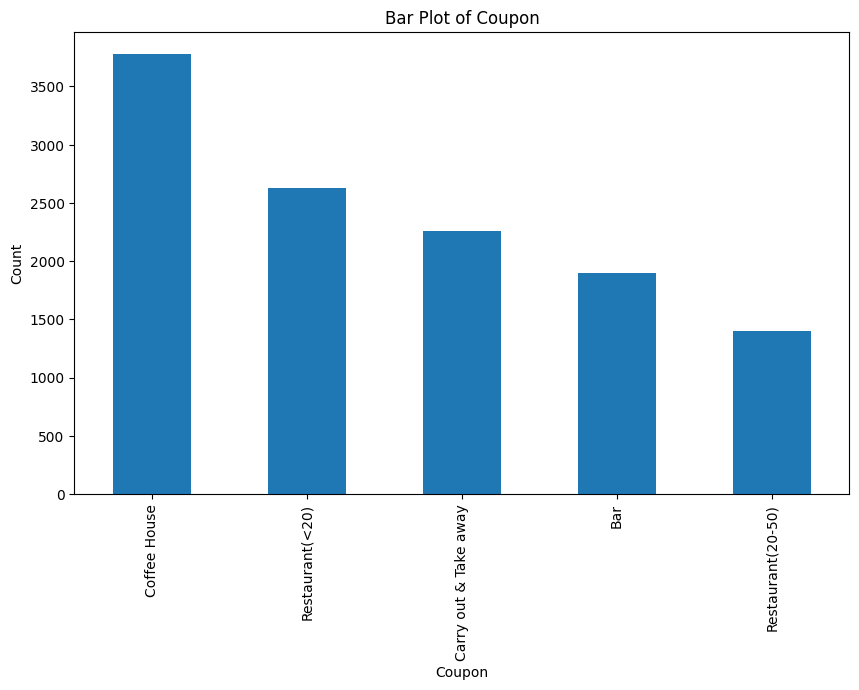

In [172]:
# Assuming 'df' is your DataFrame and 'coupon' is your column of interest
coupon_counts = data4['coupon'].value_counts()
print(type(coupon_counts))
plt.figure(figsize=(10,6))
coupon_counts.plot(kind='bar')
plt.title('Bar Plot of Coupon')
plt.xlabel('Coupon')
plt.ylabel('Count')
plt.show()

6. Use a histogram to visualize the temperature column.

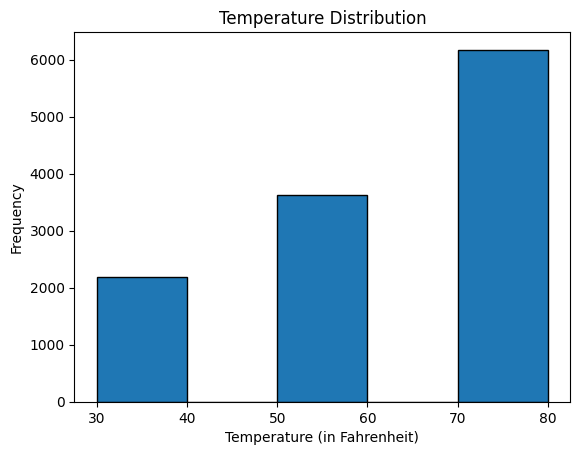

In [173]:
plt.hist(data4['temperature'], bins=5, edgecolor='black')
plt.title('Temperature Distribution')
plt.xlabel('Temperature (in Fahrenheit)')
plt.ylabel('Frequency')
plt.show()

**Investigating the Bar Coupons**

Now, we will lead you through an exploration of just the bar related coupons.  

1. Create a new `DataFrame` that contains just the bar coupons.


In [174]:
# Creates a new data frame with just the coupon equal to Bar records
bar_df = data4[data4['coupon'] == 'Bar']
bar_df

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
24,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,1
35,Home,Alone,Sunny,55,18,Bar,24,Male,21,Single,...,never,4~8,4~8,never,1,0,0,1,0,1
39,Work,Alone,Sunny,55,7,Bar,24,Male,21,Single,...,never,4~8,4~8,never,1,1,1,0,1,1
46,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,0
57,Home,Alone,Sunny,55,18,Bar,24,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12663,No Urgent Place,Friend(s),Sunny,80,22,Bar,24,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12664,No Urgent Place,Friend(s),Sunny,55,22,Bar,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12667,No Urgent Place,Alone,Rainy,55,10,Bar,24,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12670,No Urgent Place,Partner,Rainy,55,18,Bar,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0


2. What proportion of bar coupons were accepted?


In [66]:
# Determines proporation of y == 1 that accepted coupon
proportion_accept_bar = (bar_df['y'] == 1).sum() / len(bar_df)
proportion_accept_bar

0.4131578947368421

Finding: 41% of Bar coupons were Accepted

In [175]:
# 1900 records make up the coupon equals Bar data set
len(bar_df)

1900

3. Compare the acceptance rate between those who went to a bar 3 or fewer times a month to those who went more.


In [176]:
# Shows the bar visit times by frequency category
print_unique_values(bar_df, 'bar')

never
1~3
>8
4~8


In [177]:
# Creates a new data frame with just the bar records in it for 3 or less times a month
values = ['never', '1~3']
bar_df_3less = bar_df[bar_df['bar'].isin(values)]
bar_df_3less
# result 1709 records 3 or less

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
24,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,1
35,Home,Alone,Sunny,55,18,Bar,24,Male,21,Single,...,never,4~8,4~8,never,1,0,0,1,0,1
39,Work,Alone,Sunny,55,7,Bar,24,Male,21,Single,...,never,4~8,4~8,never,1,1,1,0,1,1
46,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,0
57,Home,Alone,Sunny,55,18,Bar,24,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12663,No Urgent Place,Friend(s),Sunny,80,22,Bar,24,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12664,No Urgent Place,Friend(s),Sunny,55,22,Bar,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12667,No Urgent Place,Alone,Rainy,55,10,Bar,24,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0
12670,No Urgent Place,Partner,Rainy,55,18,Bar,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0


In [185]:
# Determines the acceptance rate for the 3 or less categories
accept_bar_3less = (bar_df_3less['y'] == 1).sum()
notaccept_bar_3less = (bar_df_3less['y'] == 0).sum()
total_3less = accept_bar_3less + notaccept_bar_3less
#print(total_3less)
less3_accept_rate = accept_bar_3less / total_3less
print(less3_accept_rate)

0.37448800468110005


Finding: Bar coupon acceptance rate of 37% for 3 or less visit categories

In [184]:
# Creates a new data frame with just the bar records in it for more than 4 or more visits
values = ['>8', '4~8']
bar_df_4more = bar_df[bar_df['bar'].isin(values)]
bar_df_4more.shape
# result 191 records 4 or more

(191, 25)

In [190]:
# Determines the acceptance rate for the 4 or more categories
accept_bar_4more = (bar_df_4more['y'] == 1).sum()
notaccept_bar_4more = (bar_df_4more['y'] == 0).sum()
total_4more = accept_bar_4more + notaccept_bar_4more
more4_accept_rate = accept_bar_4more / total_4more
print(more4_accept_rate)

0.7591623036649214


Finding: Bar coupon acceptance rate of 76% for 4 or more visit categories

In [189]:
bar_accept_compare = more4_accept_rate - less3_accept_rate
bar_accept_compare

0.3846742989838214

Finding: The acceptance rate is higher for the 4 or more categories by 38% over the 3 or less category's

4. Compare the acceptance rate between drivers who go to a bar more than once a month and are over the age of 25 to the all others.  Is there a difference?


In [111]:
# Shows all the unique age values in column 'age'
print_unique_values(bar_df, 'age')

21
46
26
31
41
50plus
36
below21


In [128]:
# Shows all the unique age values in column 'age'
print_unique_values(bar_df, 'occupation')

Architecture & Engineering
Student
Education&Training&Library
Unemployed
Healthcare Support
Healthcare Practitioners & Technical
Sales & Related
Management
Arts Design Entertainment Sports & Media
Computer & Mathematical
Life Physical Social Science
Personal Care & Service
Office & Administrative Support
Construction & Extraction
Legal
Retired
Community & Social Services
Installation Maintenance & Repair
Transportation & Material Moving
Business & Financial
Protective Service
Food Preparation & Serving Related
Production Occupations
Building & Grounds Cleaning & Maintenance
Farming Fishing & Forestry


In [127]:
# Shows all the unique age values in column 'age'
print_unique_values(bar_df, 'passenger')

Friend(s)
Alone
Kid(s)
Partner


In [191]:
# Creates a new data frame 
values = ['>8', '4~8', '1~3']
values_2 = ['46', '26', '31', '41', '50plus', '36']
bar_df_1more_great25 = bar_df[(bar_df['bar'].isin(values) & bar_df['age'].isin(values_2))]
bar_df_1more_great25


,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
112,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,26,Unmarried partner,...,>8,4~8,1~3,never,1,0,0,0,1,1
123,Home,Alone,Sunny,55,18,Bar,24,Male,26,Unmarried partner,...,>8,4~8,1~3,never,1,0,0,1,0,1
127,Work,Alone,Sunny,55,7,Bar,24,Male,26,Unmarried partner,...,>8,4~8,1~3,never,1,1,1,0,1,1
156,No Urgent Place,Friend(s),Sunny,80,10,Bar,24,Male,26,Single,...,>8,>8,>8,>8,1,0,0,0,1,1
167,Home,Alone,Sunny,55,18,Bar,24,Male,26,Single,...,>8,>8,>8,>8,1,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12481,No Urgent Place,Friend(s),Sunny,80,22,Bar,24,Female,26,Unmarried partner,...,never,4~8,4~8,never,1,1,0,0,1,1
12482,No Urgent Place,Friend(s),Sunny,55,22,Bar,2,Female,26,Unmarried partner,...,never,4~8,4~8,never,1,1,0,0,1,1
12485,No Urgent Place,Alone,Rainy,55,10,Bar,24,Female,26,Unmarried partner,...,never,4~8,4~8,never,1,1,0,0,1,1
12488,No Urgent Place,Partner,Rainy,55,18,Bar,2,Female,26,Unmarried partner,...,never,4~8,4~8,never,1,1,0,0,1,1


In [192]:
# result 401 records 1 or more and greater than age of 25
accept_bar_1more_greater25 = (bar_df_1more_great25['y'] == 1).sum()
notaccept_bar_1more_greater25 = (bar_df_1more_great25['y'] == 0).sum()
total_greater25 = accept_bar_1more_greater25 + notaccept_bar_1more_greater25
great25_rate_accept = accept_bar_1more_greater25 / total_greater25
print(great25_rate_accept)

0.6882793017456359


Finding: Rate for greater than 25 is 69%

In [194]:
# Creates a new data frame, the question is unclear on what "all others is" I will assume that is everyone 25 years and younger
values = ['>8', '4~8', '1~3']
values_3 = ['21', 'below21']
bar_df_1more_25less = bar_df[(bar_df['bar'].isin(values) & bar_df['age'].isin(values_3))]


In [196]:
accept_bar_1more_less25 = (bar_df_1more_25less['y'] == 1).sum()
notaccept_bar_1more_less25 = (bar_df_1more_25less['y'] == 0).sum()
total_25less = accept_bar_1more_less25 + notaccept_bar_1more_less25
less25_rate_accept = accept_bar_1more_less25 / total_25less
print(less25_rate_accept)

0.6745562130177515


Finding: Rate for 25 or less age group is 67%

5. Use the same process to compare the acceptance rate between drivers who go to bars more than once a month and had passengers that were not a kid and had occupations other than farming, fishing, or forestry. 


Note to the class administrators this question and a couple others are not clear enough, there is not clear punction in the statements to ensure I get the right context for the question. Too much is assumed. It is important these questions are written more clearly. I had to assume things here to complete the work.  E.g. "compare the acceptant rate," does that mean the same data set for not accepted, does it me the inverse of what is left in each column value that was not in the first group. Please not grade down because of this issue. I even sent a support ticket and did not get a clear answer to my Support ticket.

Finding: The group that was larger below in the first cell below indicated a higher acceptance rate

In [159]:
values_4 = ['>8', '4~8', '1~3']
values_5 = ['Kid(s)']
values_6 = ['Farming Fishing & Forestry']
bar_accept_1more_passnotkid_occ = bar_df[bar_df['bar'].isin(values_4) & (~bar_df['passenger'].isin(values_5)) & (~bar_df['occupation'].isin(values_6))]

bar_accepted = (bar_accept_1more_passnotkid_occ['y'] == 1).sum() 
bar_accepted_other = (bar_accept_1more_passnotkid_occ['y'] == 0).sum() 
Total_bar = bar_accepted + bar_accepted_other
print(Total_bar)

print(bar_accepted)
print(bar_accepted_other)

528
374
154


In [160]:
PJ_prop=bar_accepted / Total_bar
print(PJ_prop)

0.7083333333333334


Finding: 70% of acceptance rate for bar coupons for all other occupations

In [162]:
values_7 = ['>8', '4~8', '1~3']
values_8 = ['Kid(s)']
values_9 = ['Farming Fishing & Forestry']
bar_accept_1more_passnotkid_occ_inverse = bar_df[(~bar_df['bar'].isin(values_7)) & (bar_df['passenger'].isin(values_8)) & (bar_df['occupation'].isin(values_9))]

bar_accepted2 = (bar_accept_1more_passnotkid_occ_inverse['y'] == 1).sum() 
bar_accepted_other2 = (bar_accept_1more_passnotkid_occ_inverse['y'] == 0).sum() 
Total_bar = bar_accepted2 + bar_accepted_other2
print(Total_bar)

print(bar_accepted2)
print(bar_accepted_other2)


3
1
2


In [163]:
PJ_prop=bar_accepted2 / Total_bar
print(PJ_prop)

0.3333333333333333


Finding: 33% of acceptance rate for bar coupons for Farming Fishing & Forestry occupation

6. Compare the acceptance rates between those drivers who:

- go to bars more than once a month, had passengers that were not a kid, and were not widowed *OR*
- go to bars more than once a month and are under the age of 30 *OR*
- go to cheap restaurants more than 4 times a month and income is less than 50K. 



In [200]:
values_7 = ['>8', '4~8', '1~3']
values_8 = ['Kid(s)']
values_9 = ['Widowed']
bar_pass_nokid_notwidow = bar_df[(bar_df['bar'].isin(values_7)) & (~bar_df['passenger'].isin(values_8)) & (~bar_df['maritalstatus'].isin(values_9))]

bar_accepted2 = (bar_pass_nokid_notwidow['y'] == 1).sum()
bar_notaccepted2 = (bar_pass_nokid_notwidow['y'] == 0).sum()
Total_bar = bar_accepted2 + bar_notaccepted2
print(Total_bar)
rate_nonwidowed = bar_accepted2 / Total_bar
print(rate_nonwidowed)

528
0.7083333333333334


Finding: Acceptance rate of 71% for go to bars more than once a month, had passengers that were not a kid, and were not widowed

In [202]:
values_7 = ['>8', '4~8', '1~3']
values_8 = ['below21', '21', '26']
bar_under30 = bar_df[(bar_df['bar'].isin(values_7)) & (bar_df['age'].isin(values_8))]

bar_accepted3 = (bar_under30['y'] == 1).sum()
bar_notaccepted3 = (bar_under30['y'] == 0).sum()
Total_bar = bar_accepted3 + bar_notaccepted3
print(Total_bar)
rate_under30 = bar_accepted3 / Total_bar
print(rate_under30)

326
0.7177914110429447


Finding: Acceptance rate of 72% for go to bars more than once a month and are under the age of 30

In [208]:
values_7 = ['4~8', '>8']
values_8 = ['$37500 - $49999', '$12500 - $24999', '$25000 - $37499', 'Less than $12500']
bar_cheap_lowincome = bar_df[(bar_df['restaurantlessthan20'].isin(values_7)) & (bar_df['income'].isin(values_8))]

bar_accepted4 = (bar_cheap_lowincome['y'] == 1).sum()
bar_notaccepted4 = (bar_cheap_lowincome['y'] == 0).sum()
Total_bar = bar_accepted4 + bar_notaccepted4
print(Total_bar)
rate_cheap_lowincome = bar_accepted4 / Total_bar
print(rate_cheap_lowincome)

333
0.45645645645645644


Finding: Acceptance rate of 46% for go to cheap restaurants more than 4 times a month and income is less than 50K.

Problem 6 Finding: Of all three categories rates the first two were almost equal by 1%, the last category was 46% acceptance rate

7.  Based on these observations, what do you hypothesize about drivers who accepted the bar coupons?

Hypothesis: It appears in many data subsets the Acceptance rate is about 67% to 72%, though more so for those that visited more per month

### Independent Investigation

Using the bar coupon example as motivation, you are to explore one of the other coupon groups and try to determine the characteristics of passengers who accept the coupons.  

In [98]:
# new dataframe of just the Coffee House coupons
coffee_df = data4[data4['coupon'] == 'Coffee House']
coffee_df


,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
23,No Urgent Place,Friend(s),Sunny,80,10,Coffee House,2,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,0
26,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,0
27,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,2,Male,21,Single,...,never,4~8,4~8,never,1,1,0,0,1,0
28,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,...,never,4~8,4~8,never,1,1,0,0,1,0
30,No Urgent Place,Friend(s),Sunny,80,18,Coffee House,2,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12656,Home,Alone,Snowy,30,22,Coffee House,2,Male,31,Married partner,...,never,4~8,>8,never,1,1,0,0,1,0
12659,Work,Alone,Snowy,30,7,Coffee House,24,Male,31,Married partner,...,never,4~8,>8,never,1,0,0,1,0,0
12674,Home,Alone,Rainy,55,22,Coffee House,2,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,1,0,0
12675,Home,Alone,Snowy,30,22,Coffee House,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0


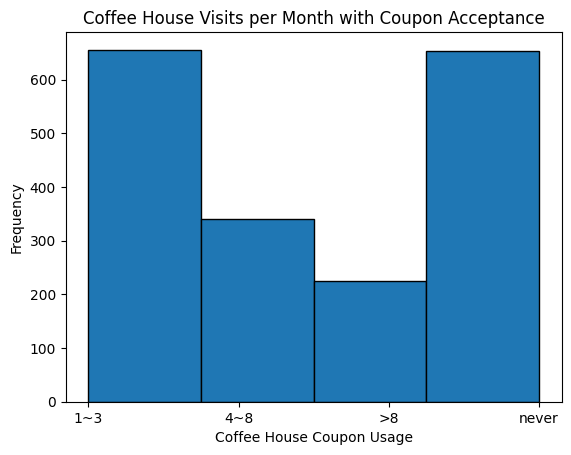

In [96]:
# Filter the dataframe for just the times a coffee coupon was Accepted
coffee_coupon_accept = coffee_df[coffee_df['y'] == 1]
#filter1_data4 = data4[data4['y'] == 1]
sorted_data = coffee_coupon_accept['coffeehouse'].sort_values()
# Plot the histogram
plt.hist(sorted_data, bins=4, edgecolor='black')

plt.title('Coffee House Visits per Month with Coupon Acceptance')
plt.xlabel('Coffee House Coupon Usage')
plt.ylabel('Frequency')
plt.show()

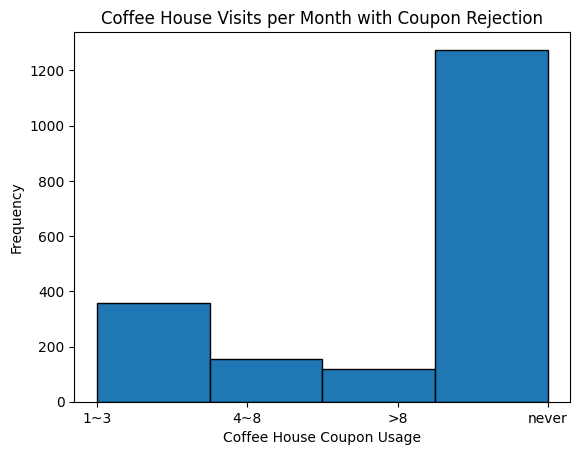

In [97]:
# Filter the dataframe for just the times a coffee coupon was rejected
coffee_coupon_reject = coffee_df[coffee_df['y'] == 0]
#filter1_data4 = data4[data4['y'] == 1]
sorted_data2 = coffee_coupon_reject['coffeehouse'].sort_values()
# Plot the histogram
plt.hist(sorted_data2, bins=4, edgecolor='black')

plt.title('Coffee House Visits per Month with Coupon Rejection')
plt.xlabel('Coffee House Coupon Usage')
plt.ylabel('Frequency')
plt.show()

In [99]:
# Number of coffee house coupons total
len(coffee_df)

3779

In [100]:
# Determines proporation of y == 1 that accepted coupon
proportion_accept_coffee = (actually_went_proportion / len(coffee_df)
proportion_accept_coffee

0.49616300608626623

In [101]:
# identifies all unique frequency groups for coffeehouse
print_unique_values(data4, 'coffeehouse')

never
4~8
1~3
>8


In [108]:
# creates a new data frame with just the coffee house records in it for at least 1 visit

values = ['4~8', '1~3', '>8']
coffee_df_1 = coffee_df[coffee_df['coffeehouse'].isin(values)]
coffee_df_1

# result 1851 at least one visit to coffee house whether they accepted the coupon or not

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
45,No Urgent Place,Friend(s),Sunny,80,10,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,1
48,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,1
49,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,1,0,0,1,1
50,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,46,Single,...,4~8,1~3,1~3,never,1,1,0,0,1,0
52,No Urgent Place,Friend(s),Sunny,80,18,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12360,Home,Alone,Snowy,30,22,Coffee House,2,Female,31,Single,...,4~8,never,4~8,1~3,1,1,0,0,1,0
12366,Work,Alone,Snowy,30,7,Coffee House,24,Female,31,Single,...,4~8,never,4~8,1~3,1,0,0,1,0,1
12624,Home,Alone,Rainy,55,22,Coffee House,2,Female,21,Unmarried partner,...,4~8,1~3,1~3,never,1,0,0,1,0,1
12625,Home,Alone,Snowy,30,22,Coffee House,2,Female,21,Unmarried partner,...,4~8,1~3,1~3,never,1,1,0,0,1,0


In [107]:
# creates a new data frame with just the coffee house records in it for at least 1 visit

values = ['never']
coffee_df_2 = coffee_df[coffee_df['coffeehouse'].isin(values)]
coffee_df_2

# result 1928 never went to a coffee shop whether they accepted or rejected the coupon

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
23,No Urgent Place,Friend(s),Sunny,80,10,Coffee House,2,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,0
26,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,0
27,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,2,Male,21,Single,...,never,4~8,4~8,never,1,1,0,0,1,0
28,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,...,never,4~8,4~8,never,1,1,0,0,1,0
30,No Urgent Place,Friend(s),Sunny,80,18,Coffee House,2,Male,21,Single,...,never,4~8,4~8,never,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12656,Home,Alone,Snowy,30,22,Coffee House,2,Male,31,Married partner,...,never,4~8,>8,never,1,1,0,0,1,0
12659,Work,Alone,Snowy,30,7,Coffee House,24,Male,31,Married partner,...,never,4~8,>8,never,1,0,0,1,0,0
12674,Home,Alone,Rainy,55,22,Coffee House,2,Male,26,Single,...,never,1~3,4~8,1~3,1,0,0,1,0,0
12675,Home,Alone,Snowy,30,22,Coffee House,2,Male,26,Single,...,never,1~3,4~8,1~3,1,1,0,0,1,0


In [110]:
A1=coffee_df # all coffee coupons regadrless of acceptance or if they visited a coffee shop
A1B=coffee_df[coffee_df['y'] == 0] # coffee coupons that were delivered but not accepted
A1C=coffee_df[coffee_df['y'] == 1] # coffee coupons that were delivered and accepted
A2=coffee_df_1 # all coffee coupons delivered with those that atleast went once to a coffee shop
A3=coffee_df_2 # all coffee coupons delivered but person never made visit to shop

In [113]:
print(len(A1))
print(len(A1B))
print(len(A1C))
print(len(A2))
print(len(A3))

3779
1904
1875
1851
1928


In [117]:
Went_Accepted = A2[A2['y'] == 1]
Went_Accepted

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
45,No Urgent Place,Friend(s),Sunny,80,10,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,1
48,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,1
49,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,1,0,0,1,1
54,No Urgent Place,Friend(s),Sunny,55,14,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,1
56,No Urgent Place,Alone,Sunny,55,10,Coffee House,2,Male,46,Single,...,4~8,1~3,1~3,never,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12258,Work,Alone,Snowy,30,7,Coffee House,24,Male,50plus,Married partner,...,1~3,4~8,1~3,1~3,1,0,0,1,0,1
12279,Work,Alone,Snowy,30,7,Coffee House,24,Male,26,Single,...,>8,4~8,4~8,4~8,1,0,0,1,0,1
12366,Work,Alone,Snowy,30,7,Coffee House,24,Female,31,Single,...,4~8,never,4~8,1~3,1,0,0,1,0,1
12624,Home,Alone,Rainy,55,22,Coffee House,2,Female,21,Unmarried partner,...,4~8,1~3,1~3,never,1,0,0,1,0,1


Coupon Delivered and Accepted - Went to Coffee House Proportion

In [119]:
prop_went_accepted = len(Went_Accepted) / len(A2)
print(prop_went_accepted)

0.6601836844948676


In [116]:
Never_Went_Accepted = A3[A3['y'] == 1]
Never_Went_Accepted

,destination,passenger,weather,temperature,time,coupon,expiration,gender,age,maritalstatus,...,coffeehouse,carryaway,restaurantlessthan20,restaurant20to50,tocoupon_geq5min,tocoupon_geq15min,tocoupon_geq25min,direction_same,direction_opp,y
89,No Urgent Place,Friend(s),Sunny,80,10,Coffee House,2,Male,21,Single,...,never,1~3,never,1~3,1,0,0,0,1,1
92,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,...,never,1~3,never,1~3,1,0,0,0,1,1
93,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,2,Male,21,Single,...,never,1~3,never,1~3,1,1,0,0,1,1
94,No Urgent Place,Friend(s),Sunny,80,14,Coffee House,24,Male,21,Single,...,never,1~3,never,1~3,1,1,0,0,1,1
96,No Urgent Place,Friend(s),Sunny,80,18,Coffee House,2,Male,21,Single,...,never,1~3,never,1~3,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12476,Work,Alone,Snowy,30,7,Coffee House,24,Male,41,Divorced,...,never,never,1~3,4~8,1,0,0,1,0,1
12565,Work,Alone,Snowy,30,7,Coffee House,24,Female,26,Married partner,...,never,1~3,1~3,never,1,0,0,1,0,1
12579,Home,Alone,Rainy,55,22,Coffee House,2,Male,21,Single,...,never,1~3,1~3,never,1,0,0,1,0,1
12601,Home,Alone,Rainy,55,22,Coffee House,2,Female,50plus,Divorced,...,never,1~3,1~3,never,1,0,0,1,0,1


Coupon Delivered and Accepted - Never Went Proportion

In [121]:
prop_never_went_accepted = len(Never_Went_Accepted) / len(A3)
print(prop_never_went_accepted)

0.3386929460580913


 For those that received a coffee house coupon then accepted it. 2/3 then went to a coffee house versus 1/3 who did not. The result shows the coupon had an affect on visits to the coffee house.

In [ ]:
Accepted_Went = len(A1C) / len(

In [105]:
actually_went_proportion = len(coffee_df_1) / len()
print(actually_went_proportion)

# proportion_accept_coffee_visit = (coffee_df['y'] == 1).sum() / len(coffee_df)

0.489812119608362


In this section I will now analyze what the type of 'passenger' will me to the same ratios

In [122]:
# Use a defined function from earlier in the notebook I created to identify all the unique values in a column; this case passenger
print_unique_values(data4, 'passenger')

Alone
Friend(s)
Kid(s)
Partner


Below the histogram shows for those getting a Coffee House coupon and Accepting it, then visiting a Coffee House they were mostly people alone or with a friend(s)

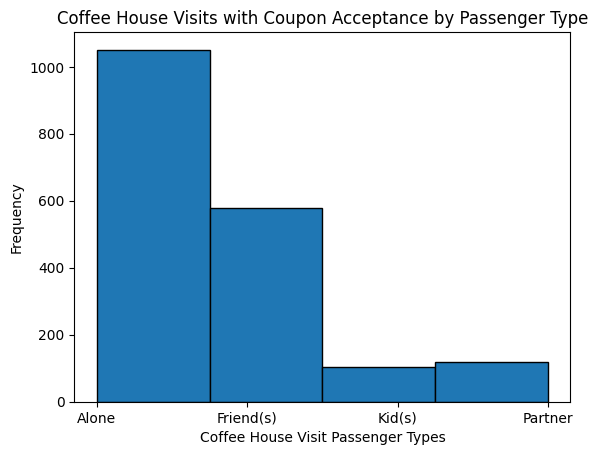

In [124]:
# Filter the dataframe for just the times a coffee coupon was Accepted
#coffee_coupon_accept = coffee_df[coffee_df['y'] == 1]
#filter1_data4 = data4[data4['y'] == 1]
sorted_data = A2['passenger'].sort_values()
# Plot the histogram
plt.hist(sorted_data, bins=4, edgecolor='black')

plt.title('Coffee House Visits with Coupon Acceptance by Passenger Type')
plt.xlabel('Coffee House Visit Passenger Types')
plt.ylabel('Frequency')
plt.show()